In [1]:
# RUN THIS IN THE VERY FIRST CELL
%env HF_HUB_OFFLINE=1

import os
os.environ["HF_HUB_OFFLINE"] = "1"

print("Offline mode forced.")

import torch
import numpy as np

env: HF_HUB_OFFLINE=1
Offline mode forced.


In [2]:
from models.qwen2_5vl import Qwen2_5VL
from models import Qwen3VL
#qwen_model = Qwen2_5VL()
qwen_model3 = Qwen3VL()

/leonardo/home/userexternal/lzhou001/miniconda3/envs/EfficientGEBD/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/leonardo/home/userexternal/lzhou001/miniconda3/envs/EfficientGEBD/lib/python3.10/site-packages/transformers/utils/hub.py:110: FutureWarning: Using `TRANSFORMERS_CACHE` is deprecated and will be removed in v5 of Transformers. Use `HF_HOME` instead.
  warnings.warn(
/leonardo/home/userexternal/lzhou001/miniconda3/envs/EfficientGEBD/lib/python3.10/site-packages/transformers/models/auto/modeling_auto.py:2284: FutureWarning: The class `AutoModelForVision2Seq` is deprecated and will be removed in v5.0. Please use `AutoModelForImageTextToText` instead.
  warnings.warn(
`torch_dtype` is deprecated! Use `dtype` instead!
Loading checkpoint shards: 100%|███████████████████████████████████████████████

In [3]:
from datasets.annot_utils import load_gt_annotations, get_video_gt_info
from datasets.tapos1 import TaposDataset

BASE_DIR = "data/TAPOS/images/val"
SPLIT_FILE = "random_100_val_split.txt"
GT_ANNOTATION_PATH = "data/TAPOS/tapos_gt_val.pkl"

tapos_dataset = TaposDataset(
    base_dir=BASE_DIR,
    split_file=SPLIT_FILE,
    gt_annotation_path=GT_ANNOTATION_PATH,
    chunk_duration=0.5,
    num_frames_per_chunk=8)

Loaded annotations for 1755 videos.


In [4]:
import matplotlib.pyplot as plt
def plot_image_grid(image_rows, figsize_per_image=3):
    """
    image_rows: List[List[PIL.Image.Image]]
        Each inner list is a row of images.
    figsize_per_image: float
        Controls overall figure size.
    """
    num_rows = len(image_rows)
    num_cols = max(len(row) for row in image_rows)

    fig, axes = plt.subplots(
        num_rows,
        num_cols,
        figsize=(figsize_per_image * num_cols, figsize_per_image * num_rows)
    )

    # Handle edge cases where rows or cols == 1
    if num_rows == 1:
        axes = [axes]
    if num_cols == 1:
        axes = [[ax] for ax in axes]

    for r, row in enumerate(image_rows):
        for c, img in enumerate(row):
            axes[r][c].imshow(img)
            axes[r][c].axis("off")

        # Hide unused cells in this row
        for c in range(len(row), num_cols):
            axes[r][c].axis("off")

    plt.tight_layout()
    plt.show()

In [43]:
video = tapos_dataset[9]
video_chunks = video['chunks']
video_fps = video['fps']
first_chunk = video_chunks[0]

First chunk: description: A female athlete is running on a track.
Second chunk: description: A woman is running on a track.
First chunk without first frame: description: A woman is running on a track.
Second chunk without first frame: description: A woman is running on a track.


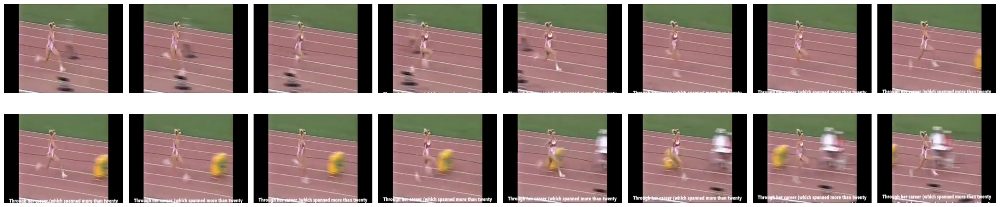

In [8]:
prompt = "Describe the single observable action or event in this 0.5 second video segment."
#prompt = "Describe the state of the main event of the video in this 0.5 second video segment."
#prompt = "Describe the single observable event that occurs in this video clip."
#prompt = "Briefly describe the action/event that just started in the current video segment. Describe only on the main actions or events taking place. IMPORTANT: Describe only what is in the current segment."
#prompt = "Briefly describe the action/event that just started in the current video segment. IMPORTANT: Describe only what is in the current segment."

current_description = qwen_model.infer(video_chunks[0], prompt, sample_fps=video_fps)

print(f"First chunk: description: {current_description}")

current_description_second_chunk = qwen_model.infer(video_chunks[1], prompt, sample_fps=video_fps)
print(f"Second chunk: description: {current_description_second_chunk}")

current_description_wo_first_frame = qwen_model.infer(video_chunks[0][1:], prompt, sample_fps=video_fps)
print(f"First chunk without first frame: description: {current_description_wo_first_frame}")

current_description_second_chunk_wo_first_frame = qwen_model.infer(video_chunks[1][1:], prompt, sample_fps=video_fps)
print(f"Second chunk without first frame: description: {current_description_second_chunk_wo_first_frame}")

plot_image_grid(video_chunks[0:2])

The following generation flags are not valid and may be ignored: ['temperature', 'top_p', 'top_k']. Set `TRANSFORMERS_VERBOSITY=info` for more details.


First chunk: description: A female track and field athlete is running on a track.
Second chunk: description: A female athlete runs on a track.
First chunk without first frame: description: A female athlete is running on a track.
Second chunk without first frame: description: A female athlete runs on a track while a yellow object moves quickly past her.


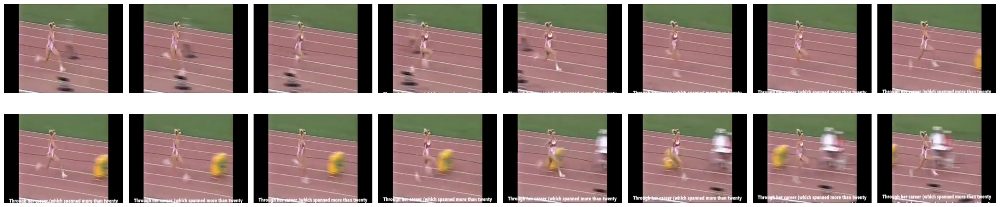

In [9]:
prompt = "Describe the single observable action or event in this 0.5 second video segment."
#prompt = "Describe the state of the main event of the video in this 0.5 second video segment."
#prompt = "Describe the single observable event that occurs in this video clip."
#prompt = "Briefly describe the action/event that just started in the current video segment. Describe only on the main actions or events taking place. IMPORTANT: Describe only what is in the current segment."
#prompt = "Briefly describe the action/event that just started in the current video segment. IMPORTANT: Describe only what is in the current segment."

current_description = qwen_model3.infer(video_chunks[0], prompt, sample_fps=video_fps)

print(f"First chunk: description: {current_description}")

current_description_second_chunk = qwen_model3.infer(video_chunks[1], prompt, sample_fps=video_fps)
print(f"Second chunk: description: {current_description_second_chunk}")

current_description_wo_first_frame = qwen_model3.infer(video_chunks[0][1:], prompt, sample_fps=video_fps)
print(f"First chunk without first frame: description: {current_description_wo_first_frame}")

current_description_second_chunk_wo_first_frame = qwen_model3.infer(video_chunks[1][1:], prompt, sample_fps=video_fps)
print(f"Second chunk without first frame: description: {current_description_second_chunk_wo_first_frame}")

plot_image_grid(video_chunks[0:2])

In [13]:
alignment_prompt = "Given the previous event description: {previous_description}, is this the same event? Respond ONLY with 'YES' or 'NO."
#alignment_prompt = "Does the video segment show exactly: {previous_description}? Respond ONLY with 'YES' or 'NO'."
alignment_prompt = alignment_prompt.format(previous_description=current_description)

cand_probs_list = []

for idx, chunk in enumerate(video_chunks[1:]):
    frame_chunk = chunk
    inputs = qwen_model._prepare_inputs(frame_chunk, alignment_prompt, sample_fps=video_fps)
    cand_prob = qwen_model.get_next_token_probs(frame_chunk, alignment_prompt, sample_fps=video_fps, candidate_strings=["YES", "NO"])
    cand_probs_list.append(cand_prob)

cand_probs_list, video["chunk_labels"]

# Assuming 'cand_probs_list' and 'video' are defined as in your snippet

# 1. Flatten the labels list (since it's inside a nested list [[...]])
chunk_labels = video["chunk_labels"][0]

# 2. Iterate starting from the second entry (index 1) of cand_probs_list
#    and the first entry (index 0) of chunk_labels simultaneously.
#    We use zip to pair them up safely.
for prob_entry, label in zip(cand_probs_list, chunk_labels[1:]):
    prob_entry['LABEL'] = label

cand_probs_list

[{'YES': 0.65625, 'NO': 0.310546875, 'LABEL': 0},
 {'YES': 0.625, 'NO': 0.333984375, 'LABEL': 0},
 {'YES': 0.62890625, 'NO': 0.3359375, 'LABEL': 0},
 {'YES': 0.65234375, 'NO': 0.30859375, 'LABEL': 0},
 {'YES': 0.65625, 'NO': 0.30859375, 'LABEL': 0},
 {'YES': 0.70703125, 'NO': 0.259765625, 'LABEL': 0},
 {'YES': 0.66015625, 'NO': 0.310546875, 'LABEL': 1},
 {'YES': 0.7109375, 'NO': 0.26171875, 'LABEL': 0},
 {'YES': 0.66015625, 'NO': 0.310546875, 'LABEL': 0},
 {'YES': 0.734375, 'NO': 0.2392578125, 'LABEL': 0},
 {'YES': 0.734375, 'NO': 0.23828125, 'LABEL': 0},
 {'YES': 0.7109375, 'NO': 0.26171875, 'LABEL': 0},
 {'YES': 0.62890625, 'NO': 0.3359375, 'LABEL': 0},
 {'YES': 0.62890625, 'NO': 0.3359375, 'LABEL': 0},
 {'YES': 0.6796875, 'NO': 0.283203125, 'LABEL': 0},
 {'YES': 0.65625, 'NO': 0.30859375, 'LABEL': 0},
 {'YES': 0.70703125, 'NO': 0.259765625, 'LABEL': 0},
 {'YES': 0.77734375, 'NO': 0.197265625, 'LABEL': 1},
 {'YES': 0.734375, 'NO': 0.23828125, 'LABEL': 0}]

In [ ]:
#alignment_prompt = "Given the previous event description: {previous_description}, is this the same event? Respond ONLY with 'YES' or 'NO."
alignment_prompt = "Does the video segment show exactly: {previous_description}? Respond ONLY with 'YES' or 'NO'."
alignment_prompt = alignment_prompt.format(previous_description=current_description)

cand_probs_list = []

for idx, chunk in enumerate(video_chunks[1:]):
    frame_chunk = chunk
    inputs = qwen_model3._prepare_inputs(frame_chunk, alignment_prompt, sample_fps=video_fps)
    cand_prob = qwen_model3.get_next_token_probs(frame_chunk, alignment_prompt, sample_fps=video_fps, candidate_strings=["YES", "NO"])
    cand_probs_list.append(cand_prob)

cand_probs_list, video["chunk_labels"]

# Assuming 'cand_probs_list' and 'video' are defined as in your snippet

# 1. Flatten the labels list (since it's inside a nested list [[...]])
chunk_labels = video["chunk_labels"][0]

# 2. Iterate starting from the second entry (index 1) of cand_probs_list
#    and the first entry (index 0) of chunk_labels simultaneously.
#    We use zip to pair them up safely.
for prob_entry, label in zip(cand_probs_list, chunk_labels[1:]):
    prob_entry['LABEL'] = label

cand_probs_list

[{'YES': 0.87109375, 'NO': 0.049072265625, 'LABEL': 0},
 {'YES': 0.8828125, 'NO': 0.0498046875, 'LABEL': 0},
 {'YES': 0.8125, 'NO': 0.10986328125, 'LABEL': 0},
 {'YES': 0.82421875, 'NO': 0.0869140625, 'LABEL': 1},
 {'YES': 0.8125, 'NO': 0.09716796875, 'LABEL': 0},
 {'YES': 0.5625, 'NO': 0.341796875, 'LABEL': 1},
 {'YES': 0.5625, 'NO': 0.33984375, 'LABEL': 0},
 {'YES': 0.37109375, 'NO': 0.5390625, 'LABEL': 0},
 {'YES': 0.578125, 'NO': 0.310546875, 'LABEL': 0}]

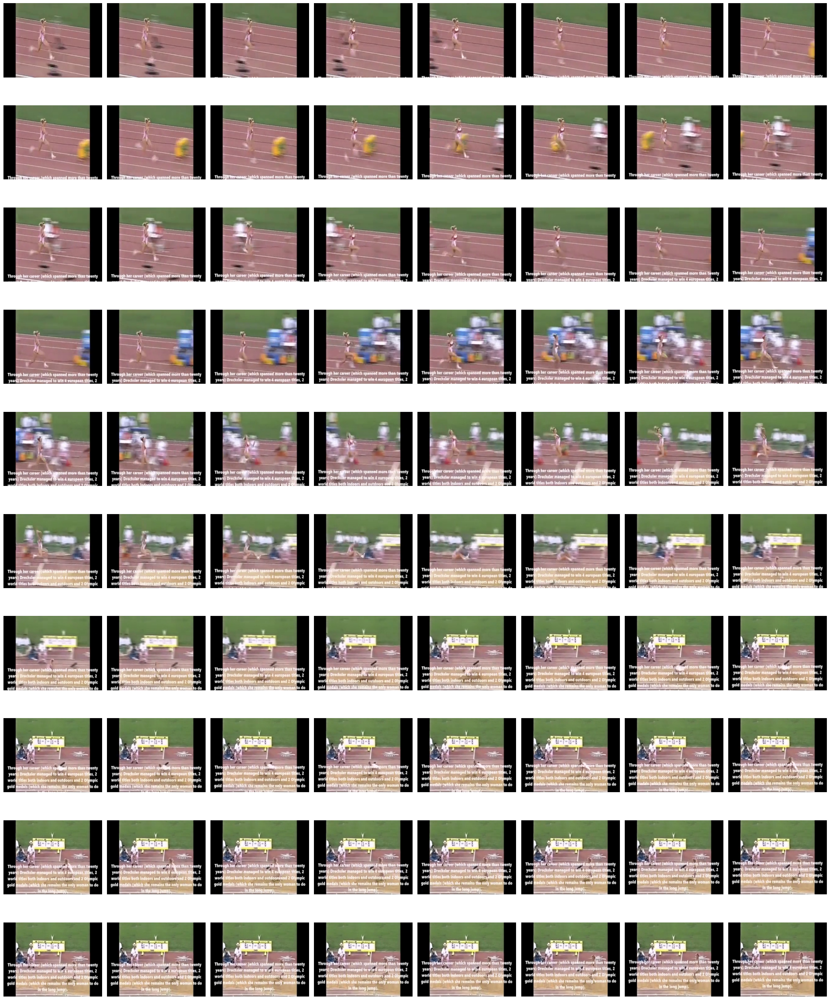

In [11]:
plot_image_grid(video_chunks)

<H1>HYPOTHESIS GENERATION

In [49]:
import random
def generate_hypothesis(conv, visual_context, num_generations=4, model=None, processor=None, rolling=False):
    rolling = True
    prompt = processor.apply_chat_template(conv, add_generation_prompt=True, tokenize=False)
    inputs = processor(
        text=prompt,
        videos=visual_context,
        return_tensors="pt",
        padding=True,
        padding_side="left",
        add_special_tokens=False,
    )

    if rolling:
        hypotheses = []
        for i in range(num_generations):
            torch.manual_seed(torch.randint(0, 2**32 - 1, (1,)).item())
            temp = 1.0 + random.uniform(-0.1, 0.1)
            top_p = 0.9 + random.uniform(-0.05, 0.05)

            outputs = model.generate(
                **inputs.to(model.device),
                do_sample=True,
                temperature=max(0.1, temp),
                top_p=max(0.1, min(0.99, top_p)),
                num_return_sequences=1,
                max_new_tokens=25,
                return_dict_in_generate=True,
                pad_token_id=processor.tokenizer.pad_token_id,
                use_cache=False,
            )
            hyp = processor.tokenizer.decode(outputs.sequences[0], skip_special_tokens=True)
            hyp = hyp.split("assistant\n")[1].replace(":", "")
            hypotheses.append(hyp)

            # Solution 4: Clear any cached states
            torch.cuda.empty_cache() if torch.cuda.is_available() else None
    else:
        outputs = model.generate(
            **inputs.to(model.device),
            do_sample=True,
            temperature=1.1,
            top_k=50,
            num_return_sequences=num_generations,
            max_new_tokens=50,
            repetition_penalty=1.55,
            no_repeat_ngram_size=3,
        )
        hypotheses = processor.batch_decode(outputs, skip_special_tokens=True)
        hypotheses = [hyp.strip().lower().split("assistant\n")[1].replace(":", "") for hyp in hypotheses]
        torch.cuda.empty_cache()
    return hypotheses


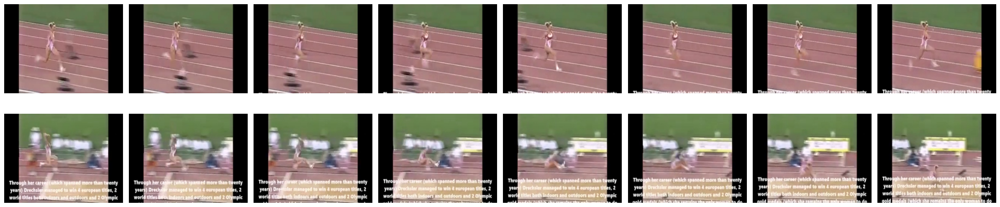

In [45]:
video = tapos_dataset[9]
video_chunks = video['chunks']
video_fps = video['fps']
first_chunk = video_chunks[0]
chunk_labels = video["chunk_labels"][0]
plot_image_grid(video_chunks[0::5])

In [46]:
prompt = "Describe the single observable action or event in this 0.5 second video segment."
#prompt = "Describe the state of the main event of the video in this 0.5 second video segment."
#prompt = "Describe the single observable event that occurs in this video clip."
#prompt = "Briefly describe the action/event that just started in the current video segment. Describe only on the main actions or events taking place. IMPORTANT: Describe only what is in the current segment."
#prompt = "Briefly describe the action/event that just started in the current video segment. IMPORTANT: Describe only what is in the current segment."

current_description = qwen_model3.infer(video_chunks[0], prompt, sample_fps=video_fps)
current_description

'A female track and field athlete is running on a track.'

In [51]:
# Sample hypotheses based on W and H
memory_text = current_description
conv = [
    {
        "role": "user",
        "content": [
            {
                "type": "text",
                "text": f"Here is what happened so far from the beginning of the video: {memory_text}",
            },
            {
                "type": "text",
                "text": (
                    "Based on this information and recent frames, "
                    "predict 3 plausible next event, each one in 8-10 words that is different the current action. "
                    "Each event should be separated with linebreak. Use the same subject previous description whenever refering to the same")
                # "text": "Based on this information, and recent frames from the video, "
                # "answer in 8-10 words what will most likely happen in the next frames.",
            },
            {"type": "video"},
        ],
    }
]


In [ ]:
context_frames = video_chunks[0]
num_hypotheses = 3

In [52]:
h0 = generate_hypothesis(
    conv,
    context_frames,
    num_generations=num_hypotheses,
    model=qwen_model3.model,
    processor=qwen_model3.processor,
    rolling=False,
)
hypotheses = h0
hypotheses_list = hypotheses[0].split('\n')
hypotheses_list.append(current_description)
hypotheses_list

['Athlete leaps into long jump pit with powerful motion.  ',
 'She lands gracefully, knees bending to absorb impact.  ',
 'Coach approaches',
 'A female track and field athlete is running on a track.']

In [53]:
def _single_id(tok: str) -> int:
        ids = qwen_model3.processor.tokenizer.encode(tok, add_special_tokens=False)
        assert len(ids) == 1, f"‘{tok}’ splits into {ids}"
        return ids[0]

yes_id = _single_id(" yes")
no_id = _single_id(" no")

In [54]:
log_like = []
logits_list = []
for hyp in hypotheses_list:
    conv_obs = [
        {
            "role": "user",
            "content": [
                {"type": "video"},
                {
                    "type": "text",
                    "text": f"Statement: {hyp}\nIs this statement true in the CURRENT video? " "Answer 'yes' or 'no'.",
                },
            ],
        }
    ]

    prompt_obs = qwen_model3.processor.apply_chat_template(conv_obs, add_generation_prompt=True)
    # print(repr(prompt_obs[-120:]))
    inp_obs = qwen_model3.processor(text=prompt_obs, videos=video_chunks[1], return_tensors="pt")

    with torch.no_grad():
        # logits shape: (batch_size, sequence_length, vocab_size)
        logits = qwen_model3.model(**inp_obs.to(qwen_model3.model.device)).logits[0, -1]

    sub_logits = logits[[yes_id, no_id]]
    logits_list.append(sub_logits)
    logprob_yes = sub_logits.log_softmax(dim=-1)[0]
    log_like.append(logprob_yes)

In [ ]:
logits_yes_no = torch.stack(logits_list)
log_probs = torch.log_softmax(logits_yes_no, dim=-1)

log_odds = log_probs[:, 0] - log_probs[:, 1]
posterior = torch.softmax(log_odds, dim=0)

In [62]:
torch.softmax(log_probs[:, 0], dim=0)

tensor([0.0342, 0.0271, 0.1206, 0.8164], device='cuda:0', dtype=torch.bfloat16)

In [101]:
log_probs, log_odds, posterior

(tensor([[-1.2266e+00, -3.4766e-01],
         [-2.3438e+00, -1.0010e-01],
         [-8.9844e-01, -5.2344e-01],
         [-1.4019e-04, -8.8750e+00]], device='cuda:0', dtype=torch.bfloat16),
 tensor([-0.8789, -2.2500, -0.3750,  8.8750], device='cuda:0',
        dtype=torch.bfloat16),
 tensor([5.8174e-05, 1.4722e-05, 9.6321e-05, 1.0000e+00], device='cuda:0',
        dtype=torch.bfloat16))

In [98]:
log_like = torch.stack(log_like)
hypothesis_probs = torch.softmax(log_like, dim=0)
hypothesis_probs

tensor([0.1631, 0.0535, 0.2266, 0.5547], device='cuda:0', dtype=torch.bfloat16)

# new hyp gen

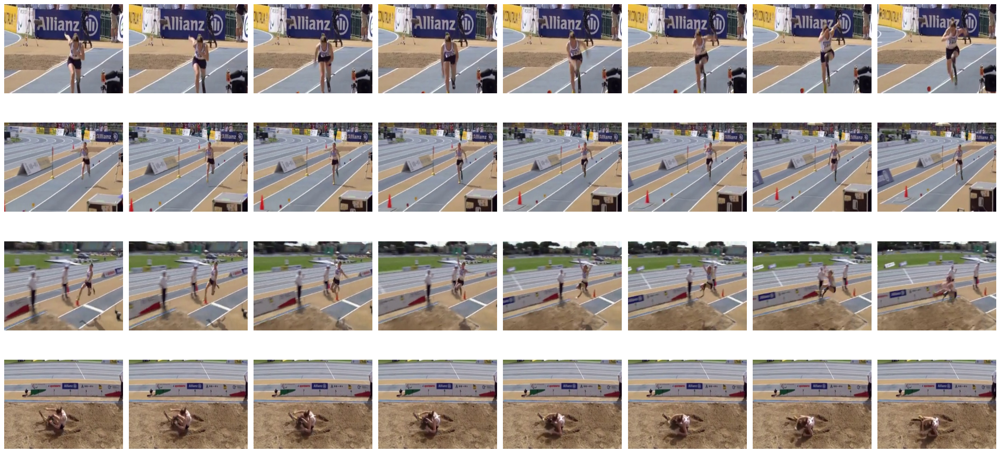

In [7]:
video = tapos_dataset[5]
video_chunks = video['chunks']
video_fps = video['fps']
first_chunk = video_chunks[0]
chunk_labels = video["chunk_labels"][0]
plot_image_grid(video_chunks[::5])

In [37]:
prompt = "Describe the single observable main action or event with 8-10 words in this 0.5 second video segment."
#prompt = "Describe the state of the main event of the video in this 0.5 second video segment."
#prompt = "Describe the single observable event that occurs in this video clip."
#prompt = "Briefly describe the action/event that just started in the current video segment. Describe only on the main actions or events taking place. IMPORTANT: Describe only what is in the current segment."
#prompt = "Briefly describe the action/event that just started in the current video segment. IMPORTANT: Describe only what is in the current segment."

current_description = qwen_model3.infer(video_chunks[0], prompt, sample_fps=video_fps)
current_description

'Female athlete runs and jumps into sand pit.'

In [38]:
from models.qwen_interface import QwenVideoReasoner
reasoner = QwenVideoReasoner(model=qwen_model3.model, processor=qwen_model3.processor)

In [39]:
hypotheses = reasoner.generate(
    memory_text=current_description,
    video_ctx=video_chunks[0],
    n_hypotheses=4,
)

In [45]:
hypotheses

['Athlete lands gracefully in sand pit.  ',
 'Referee measures jump distance carefully.  ',
 'Crowd cheers loudly for impressive leap.  ',
 'Athlete walks away, smiling at performance.',
 'Female athlete runs and jumps into sand pit.']

In [41]:
res_dict = dict()
for idx, vid_chunk in enumerate(video_chunks):
    scores = reasoner.score(hypotheses, video_chunk=vid_chunk)
    res_dict[idx] = scores
    

In [42]:
res_dict

{0: tensor([9.0790e-04, 8.0109e-04, 6.2561e-04, 9.0790e-04, 9.9609e-01],
        device='cuda:0', dtype=torch.bfloat16),
 1: tensor([1.7014e-03, 5.5313e-04, 1.6785e-04, 1.1587e-04, 9.9609e-01],
        device='cuda:0', dtype=torch.bfloat16),
 2: tensor([7.0953e-04, 2.6131e-04, 7.0953e-04, 9.0122e-05, 1.0000e+00],
        device='cuda:0', dtype=torch.bfloat16),
 3: tensor([0.0177, 0.0021, 0.0035, 0.0035, 0.9727], device='cuda:0',
        dtype=torch.bfloat16),
 4: tensor([6.6223e-03, 8.4839e-03, 3.1281e-03, 3.9673e-04, 9.8047e-01],
        device='cuda:0', dtype=torch.bfloat16),
 5: tensor([3.1738e-03, 5.4932e-04, 4.2915e-04, 2.5940e-04, 9.9609e-01],
        device='cuda:0', dtype=torch.bfloat16),
 6: tensor([2.4719e-03, 5.4932e-04, 7.5150e-04, 1.3924e-04, 9.9609e-01],
        device='cuda:0', dtype=torch.bfloat16),
 7: tensor([8.5449e-03, 1.0223e-03, 2.1667e-03, 5.4550e-04, 9.8828e-01],
        device='cuda:0', dtype=torch.bfloat16),
 8: tensor([1.7014e-03, 9.0122e-05, 7.5531e-04, 4.86

In [33]:
len(chunk_labels), len(res_dict)

(100, 100)

In [43]:
paired_res_dict = [
    {
        "chunk_idx": i,
        "pred": res_dict[i].detach().float().cpu(),
        "label": chunk_labels[i]
    }
    for i in range(min(len(chunk_labels), len(res_dict)))
]
paired_res_dict

[{'chunk_idx': 0,
  'pred': tensor([9.0790e-04, 8.0109e-04, 6.2561e-04, 9.0790e-04, 9.9609e-01]),
  'label': 0},
 {'chunk_idx': 1,
  'pred': tensor([1.7014e-03, 5.5313e-04, 1.6785e-04, 1.1587e-04, 9.9609e-01]),
  'label': 0},
 {'chunk_idx': 2,
  'pred': tensor([7.0953e-04, 2.6131e-04, 7.0953e-04, 9.0122e-05, 1.0000e+00]),
  'label': 0},
 {'chunk_idx': 3,
  'pred': tensor([0.0177, 0.0021, 0.0035, 0.0035, 0.9727]),
  'label': 0},
 {'chunk_idx': 4,
  'pred': tensor([6.6223e-03, 8.4839e-03, 3.1281e-03, 3.9673e-04, 9.8047e-01]),
  'label': 0},
 {'chunk_idx': 5,
  'pred': tensor([3.1738e-03, 5.4932e-04, 4.2915e-04, 2.5940e-04, 9.9609e-01]),
  'label': 0},
 {'chunk_idx': 6,
  'pred': tensor([2.4719e-03, 5.4932e-04, 7.5150e-04, 1.3924e-04, 9.9609e-01]),
  'label': 0},
 {'chunk_idx': 7,
  'pred': tensor([8.5449e-03, 1.0223e-03, 2.1667e-03, 5.4550e-04, 9.8828e-01]),
  'label': 0},
 {'chunk_idx': 8,
  'pred': tensor([1.7014e-03, 9.0122e-05, 7.5531e-04, 4.8637e-04, 9.9609e-01]),
  'label': 0},
 {'

In [ ]:
from methods.bsurprise.divergence_utils import kl_divergence, js_divergence, total_variation
# Reference distribution (first chunk)
ref_pred = paired_res_dict[0]['pred']

# Compute divergences for each entry vs first chunk
for entry in paired_res_dict:
    p = entry['pred']
    entry['kl'] = kl_divergence(p, ref_pred)
    entry['js'] = js_divergence(p, ref_pred)
    entry['tv'] = total_variation(p, ref_pred)

# Print results
for entry in paired_res_dict:
    print(f"Chunk {entry['chunk_idx']} (GT: {entry['label']}): KL={entry['kl']:.5f}, JS={entry['js']:.5f}, TV={entry['tv']:.5f}")

Chunk 0 (GT: 0): KL=0.00000, JS=0.00000, TV=0.00000
Chunk 1 (GT: 0): KL=0.00040, JS=0.00032, TV=0.00115
Chunk 2 (GT: 0): KL=0.00333, JS=0.00028, TV=0.00277
Chunk 3 (GT: 0): KL=0.04231, JS=0.00583, TV=0.02353
Chunk 4 (GT: 0): KL=0.02238, JS=0.00362, TV=0.01602
Chunk 5 (GT: 0): KL=0.00328, JS=0.00045, TV=0.00168
Chunk 6 (GT: 0): KL=0.00215, JS=0.00036, TV=0.00136
Chunk 7 (GT: 0): KL=0.01404, JS=0.00204, TV=0.00879
Chunk 8 (GT: 0): KL=0.00071, JS=0.00026, TV=0.00103
Chunk 9 (GT: 1): KL=0.00021, JS=0.00009, TV=0.00058
Chunk 10 (GT: 0): KL=0.70367, JS=0.05827, TV=0.16515
Chunk 11 (GT: 1): KL=0.12323, JS=0.01314, TV=0.04077
Chunk 12 (GT: 0): KL=5.87639, JS=0.51273, TV=0.89081
Chunk 13 (GT: 0): KL=6.00350, JS=0.52643, TV=0.90198
Chunk 14 (GT: 0): KL=3.92405, JS=0.30485, TV=0.65070
Chunk 15 (GT: 0): KL=4.63035, JS=0.38518, TV=0.76075
Chunk 16 (GT: 0): KL=1.28953, JS=0.10875, TV=0.29036


In [16]:
alignment_prompt = "Given the previous event description: {previous_description}, is this the same event? Respond ONLY with 'YES' or 'NO."
#alignment_prompt = "Does the video segment show exactly: {previous_description}? Respond ONLY with 'YES' or 'NO'."
alignment_prompt = alignment_prompt.format(previous_description=current_description)

cand_probs_list = []

for idx, chunk in enumerate(video_chunks[1:]):
    frame_chunk = chunk
    inputs = qwen_model3._prepare_inputs(frame_chunk, alignment_prompt, sample_fps=video_fps)
    cand_prob = qwen_model3.get_next_token_probs(frame_chunk, alignment_prompt, sample_fps=video_fps, candidate_strings=["YES", "NO"])
    cand_probs_list.append(cand_prob)

cand_probs_list, video["chunk_labels"]

# Assuming 'cand_probs_list' and 'video' are defined as in your snippet

# 1. Flatten the labels list (since it's inside a nested list [[...]])
chunk_labels = video["chunk_labels"][0]

# 2. Iterate starting from the second entry (index 1) of cand_probs_list
#    and the first entry (index 0) of chunk_labels simultaneously.
#    We use zip to pair them up safely.
for prob_entry, label in zip(cand_probs_list, chunk_labels[1:]):
    prob_entry['LABEL'] = label

cand_probs_list

[{'YES': 0.87890625, 'NO': 0.119140625, 'LABEL': 0},
 {'YES': 0.87890625, 'NO': 0.119140625, 'LABEL': 0},
 {'YES': 0.77734375, 'NO': 0.22265625, 'LABEL': 0},
 {'YES': 0.81640625, 'NO': 0.1826171875, 'LABEL': 0},
 {'YES': 0.90625, 'NO': 0.09521484375, 'LABEL': 0},
 {'YES': 0.96875, 'NO': 0.029296875, 'LABEL': 0},
 {'YES': 0.87890625, 'NO': 0.119140625, 'LABEL': 1},
 {'YES': 0.87890625, 'NO': 0.119140625, 'LABEL': 0}]

In [67]:
#alignment_prompt = "Given the previous event description: {previous_description}, is this the same event? Respond ONLY with 'YES' or 'NO."
alignment_prompt = "Does the video segment show exactly: {previous_description}? Respond ONLY with 'YES' or 'NO'."
alignment_prompt = alignment_prompt.format(previous_description=current_description)

cand_probs_list = []

for idx, chunk in enumerate(video_chunks[1:]):
    frame_chunk = chunk
    inputs = qwen_model3._prepare_inputs(frame_chunk, alignment_prompt, sample_fps=video_fps)
    cand_prob = qwen_model3.get_next_token_probs(frame_chunk, alignment_prompt, sample_fps=video_fps, candidate_strings=["YES", "NO"])
    cand_probs_list.append(cand_prob)

cand_probs_list, video["chunk_labels"]

# Assuming 'cand_probs_list' and 'video' are defined as in your snippet

# 1. Flatten the labels list (since it's inside a nested list [[...]])
chunk_labels = video["chunk_labels"][0]

# 2. Iterate starting from the second entry (index 1) of cand_probs_list
#    and the first entry (index 0) of chunk_labels simultaneously.
#    We use zip to pair them up safely.
for prob_entry, label in zip(cand_probs_list, chunk_labels[1:]):
    prob_entry['LABEL'] = label

cand_probs_list

[{'YES': 1.0, 'NO': 0.00150299072265625, 'LABEL': 0},
 {'YES': 1.0, 'NO': 0.00116729736328125, 'LABEL': 0},
 {'YES': 1.0, 'NO': 0.000335693359375, 'LABEL': 0},
 {'YES': 0.9921875, 'NO': 0.00860595703125, 'LABEL': 1},
 {'YES': 0.953125, 'NO': 0.04736328125, 'LABEL': 0},
 {'YES': 0.8515625, 'NO': 0.1484375, 'LABEL': 1},
 {'YES': 0.62109375, 'NO': 0.376953125, 'LABEL': 0},
 {'YES': 0.6796875, 'NO': 0.3203125, 'LABEL': 0},
 {'YES': 0.1826171875, 'NO': 0.81640625, 'LABEL': 0}]

full pipeline

In [5]:
import random
import numpy as np
import torch
SEED = 42
os.environ["PYTHONHASHSEED"] = str(SEED)
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed_all(SEED)

torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

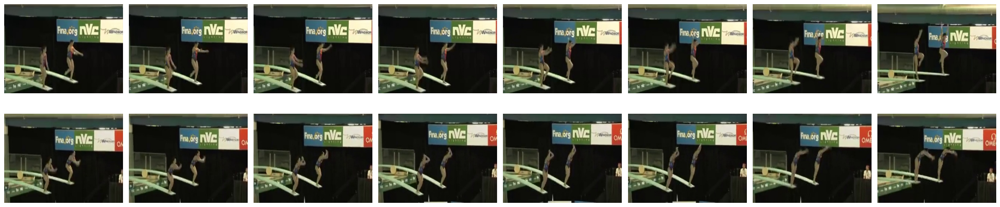

In [6]:
video = tapos_dataset[24]
video_id = video['video_id']
video_chunks = video['chunks']
video_fps = video['fps']
first_chunk = video_chunks[0]
chunk_labels = video["chunk_labels"][0]
boundary_indices = np.where(np.array(chunk_labels) == 1)[0].tolist()

indices_to_plot = sorted(list({0} | set(boundary_indices)))

chunks_to_plot = [video_chunks[i] for i in indices_to_plot]
plot_image_grid(chunks_to_plot)

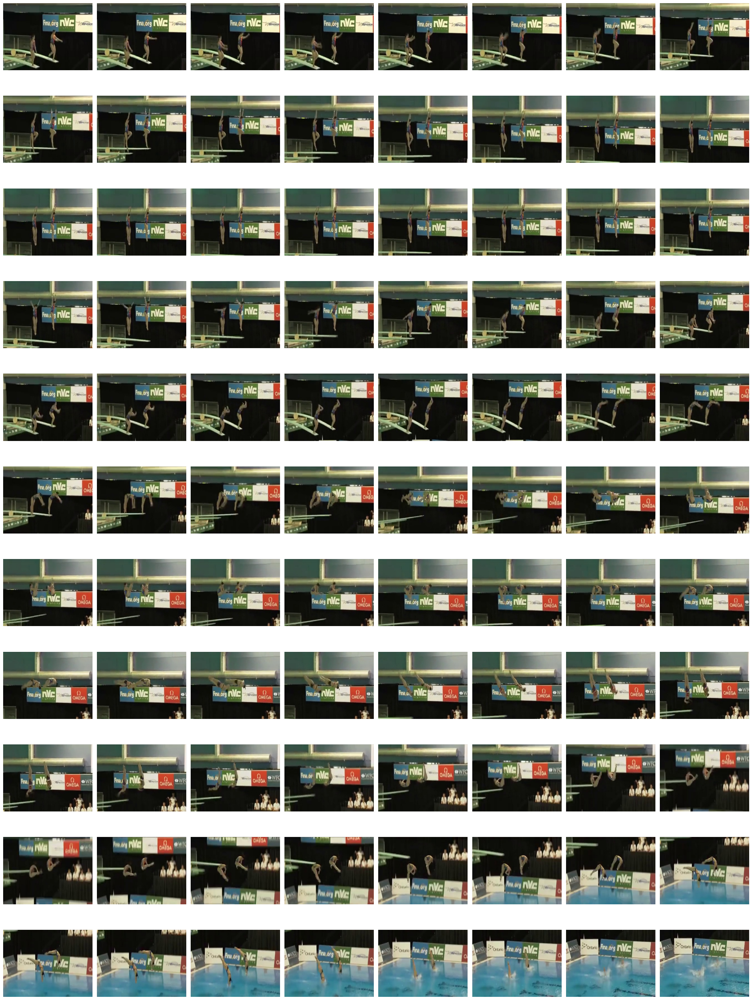

In [7]:
plot_image_grid(video_chunks)

In [7]:
from methods.bsurprise import BSurprise
bsurprise = BSurprise(qwen_interface=qwen_model3, divergence_type='kl', detection_threshold=0.5)

In [8]:
len(chunk_labels), np.where(np.array(chunk_labels) == 1)[0].tolist()

(11, [4])

In [9]:
timeline, boundaries_frames, boundaries_timestamps = bsurprise.classify_video_chunks(video_data=video, verbose=True)

Processing Video: -kQZ7nwC8NM_s00019_0_000_5_487 | Total Chunks: 11 | FPS: 16.0
GT chunk labels: [4]


The following generation flags are not valid and may be ignored: ['temperature', 'top_p', 'top_k']. Set `TRANSFORMERS_VERBOSITY=info` for more details.
Asked to sample `fps` frames per second but no video metadata was provided which is required when sampling with `fps`. Defaulting to `fps=24`. Please provide `video_metadata` for more accurate results.


Chunk 0 | New Event Description: Two divers prepare to jump off diving board.
Chunk 0 | Generated Hypotheses: ['Diver leaps off board with graceful arc.', 'Both divers execute synchronized flips mid-air.', 'One diver lands softly while other stumbles slightly.', 'Two divers prepare to jump off diving board.']
Chunk 0 | Baseline Scores: tensor([0.0369, 0.0253, 0.1001, 0.8359], device='cuda:0', dtype=torch.bfloat16)
Chunk 1 | New Scores: tensor([0.0022, 0.1182, 0.0059, 0.8750], device='cuda:0', dtype=torch.bfloat16)
Chunk 1 | Divergence: 0.3125
Chunk 2 | New Scores: tensor([0.0011, 0.0581, 0.0311, 0.9102], device='cuda:0', dtype=torch.bfloat16)
Chunk 2 | Divergence: 0.1562
Chunk 3 | New Scores: tensor([0.1426, 0.0864, 0.2070, 0.5625], device='cuda:0', dtype=torch.bfloat16)
Chunk 3 | Divergence: 0.1758
Chunk 4 | New Scores: tensor([0.0286, 0.1128, 0.0251, 0.8320], device='cuda:0', dtype=torch.bfloat16)
Chunk 4 | Divergence: 0.1167
Chunk 5 | New Scores: tensor([0.0173, 0.7383, 0.0325, 0.21

In [34]:
predictions = dict()
video_id = video['video_id']
predictions[video_id] = boundaries_frames

GT_ANNOTATION_PATH = "data/TAPOS/tapos_gt_val.pkl"
REL_DIS_THRESH = [0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.45, 0.5]


from eval import evaluate_gebd, do_eval
full_annotations_dict = load_gt_annotations(GT_ANNOTATION_PATH)

metrics_per_threshold = {}
for thres in REL_DIS_THRESH:
    f1, rec, prec = do_eval(full_annotations_dict, predictions, threshold=thres)
    metrics_per_threshold[thres] = {
        "f1": f1, "recall": rec, "precision": prec
    }
metrics_per_threshold

Loaded annotations for 1755 videos.


{0.05: {'f1': 0, 'recall': np.float64(0.0), 'precision': np.float64(0.0)},
 0.1: {'f1': 0, 'recall': np.float64(0.0), 'precision': np.float64(0.0)},
 0.15: {'f1': 0, 'recall': np.float64(0.0), 'precision': np.float64(0.0)},
 0.2: {'f1': 0, 'recall': np.float64(0.0), 'precision': np.float64(0.0)},
 0.25: {'f1': 0, 'recall': np.float64(0.0), 'precision': np.float64(0.0)},
 0.3: {'f1': np.float64(1.0),
  'recall': np.float64(1.0),
  'precision': np.float64(1.0)},
 0.35: {'f1': np.float64(1.0),
  'recall': np.float64(1.0),
  'precision': np.float64(1.0)},
 0.4: {'f1': np.float64(1.0),
  'recall': np.float64(1.0),
  'precision': np.float64(1.0)},
 0.45: {'f1': np.float64(1.0),
  'recall': np.float64(1.0),
  'precision': np.float64(1.0)},
 0.5: {'f1': np.float64(1.0),
  'recall': np.float64(1.0),
  'precision': np.float64(1.0)}}

17, 